In [1]:
import os
import pyarrow as pa

In [40]:
file_path = '../olympus-notebook/data/biolumi_sims/hits_100_10.arrow'

# Open the file
with pa.memory_map(file_path, 'r') as source:
    table = pa.ipc.open_file(source).read_all()

# Convert to a Pandas DataFrame if needed
df = table.to_pandas()

df.head()

,position,direction,initial_direction,wavelength,time,dist_travelled,module_id,base_weight,pmt_id,area_acc,abs_weight,wl_acc,ref_ix,total_weight
0,"[0.059397504, 0.001680281, 0.20141785]","[-0.12012463, -0.1385144, -0.98304826]","[-0.12012463, -0.1385144, -0.98304826]",420.0,4.810496e+06,0.919821,1,1.0,7,1,0.953485,0.263839,1.35337,0.251566
1,"[0.09818466, 0.014481293, 0.18506771]","[-0.07706574, -0.1231739, -0.9893882]","[-0.07706574, -0.1231739, -0.9893882]",420.0,9.068996e+06,0.930452,1,1.0,7,1,0.952960,0.263839,1.35337,0.251428
2,"[0.08569776, 0.0035292278, 0.19168612]","[-0.090883926, -0.13553804, -0.9865949]","[-0.090883926, -0.13553804, -0.9865949]",420.0,7.412482e+06,0.926378,1,1.0,7,1,0.953161,0.263839,1.35337,0.251481
3,"[0.18129988, -0.09366534, 0.049569517]","[0.010570219, -0.20637344, -0.9784162]","[0.010570219, -0.20637344, -0.9784162]",420.0,1.499408e+05,1.079374,1,1.0,3,1,0.945640,0.263839,1.35337,0.249497
4,"[-0.09120789, 0.020925552, 0.18799809]","[-0.27192605, -0.1126486, -0.9557021]","[-0.27192605, -0.1126486, -0.9557021]",420.0,3.045913e+06,0.960182,1,1.0,11,1,0.951494,0.263839,1.35337,0.251041


In [3]:
a=df['direction']-df['initial_direction']

In [19]:
import matplotlib.pyplot as plt
import numpy as np

In [37]:
a=np.stack(df['position'].to_numpy())
a[:,0]

array([0.0593975 , 0.09818466, 0.08569776, ..., 0.18871324, 0.17447194,
       0.17201151], dtype=float32)

In [31]:
import plotly.graph_objects as go


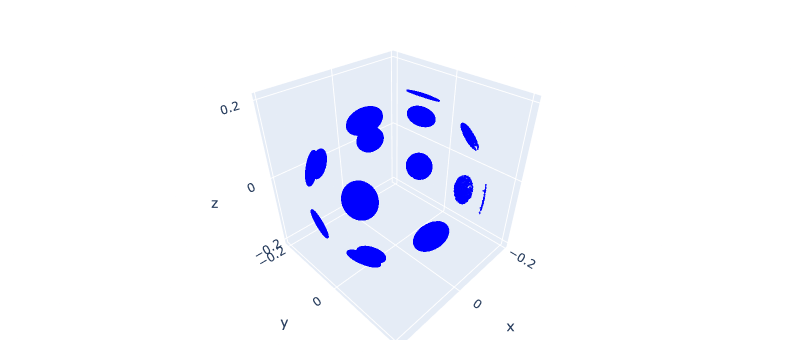

In [38]:
trace1 = go.Scatter3d(
    x=a[:,0],
    y=a[:,1],
    z=a[:,2],
    mode='markers',
    marker=dict(
        size=1,
        color='blue',
        opacity=0.8
    ),
    name='Source (for photons?)'
)
fig = go.Figure(data=[trace1])
fig.update_layout(
    margin=dict(l=20, r=20, t=20, b=20),
    #paper_bgcolor="LightSteelBlue",
)
fig.show()